# Vehicle Detection Model Training

### Import Modules

In [1]:
import warnings
warnings.filterwarnings('ignore')
!pip install --no-deps ultralytics
# Import necessary libraries
import os
import shutil
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import cv2
import yaml
from PIL import Image
from ultralytics import YOLO
from IPython.display import Video

In [2]:
# Configure the visual appearance of seaborn plots
sns.set(rc={'axes.facecolor': '#eae8fa'}, style='darkgrid')

### Load Pretrained Model

In [3]:
# Loading YOLO Pretrained model
model = YOLO('yolo11n.pt')

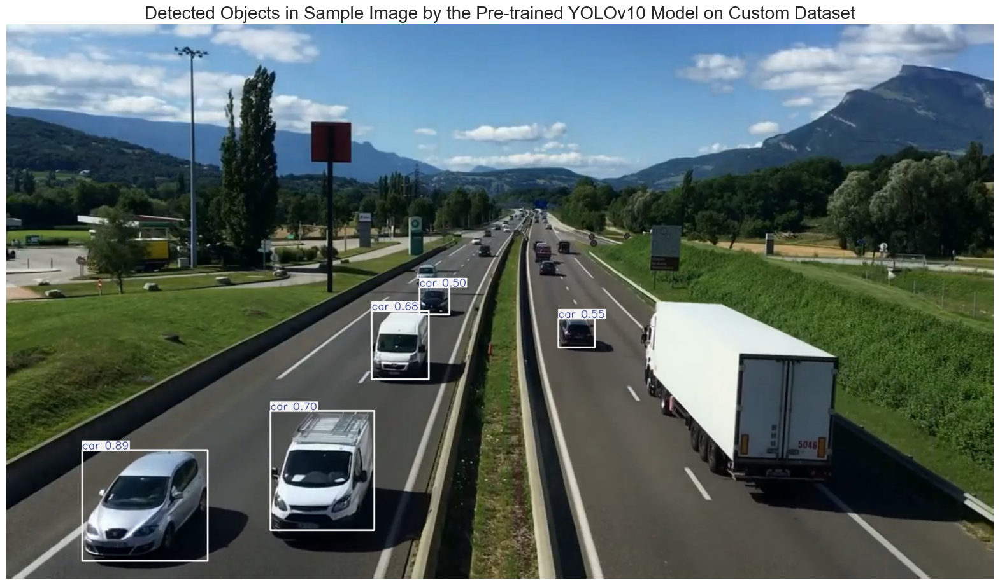

In [4]:
# Path to the image file
image_path = 'Vehicle_Dataset/sample_image.jpg'

# Perform inference on the provided image(s)
results = model.predict(source=image_path, 
                        imgsz=640,
                        verbose=False,# Resize image to 640x640 (the size pf images the model was trained on)
                        conf=0.5)   # Confidence threshold: 50% (only detections above 50% confidence will be considered)

# Annotate and convert image to numpy array
sample_image = results[0].plot(line_width=2)

# Convert the color of the image from BGR to RGB for correct color representation in matplotlib
sample_image = cv2.cvtColor(sample_image, cv2.COLOR_BGR2RGB)

# Display annotated image
plt.figure(figsize=(20,15))
plt.imshow(sample_image)
plt.title('Detected Objects in Sample Image by the Pre-trained YOLOv10 Model on Custom Dataset', fontsize=20)
plt.axis('off')
plt.show()

### Verify Dataset Configuration

In [5]:
# Define the dataset_path
dataset_path = 'Vehicle_Dataset'

# Set the path YAML file
yaml_file_path = os.path.join(dataset_path, 'data.yaml')

# Load and print the contents of the YAML file
with open(yaml_file_path, 'r') as file:
    yaml_content = yaml.load(file, Loader = yaml.FullLoader)
    print(yaml.dump(yaml_content, default_flow_style=False))

names:
- Vehicle
nc: 1
train: ../train/images
val: ../valid/images



### Exploratory Data Analysis (EDA)

In [6]:
# Set paths for trainig and validation images sets
trian_image_path = os.path.join(dataset_path, 'train', 'images')
validation_image_path = os.path.join(dataset_path, 'valid', 'images')

# Initialize counters for the number of images
num_trian_images = 0
num_valid_images = 0

# Initialize sets to hold the unique sizes of images
train_image_size = set()
valid_image_size = set()

# Check train images sizes and count
for filename in os.listdir(trian_image_path):
    if filename.endswith('.jpg'):
        num_trian_images += 1
        image_path = os.path.join(trian_image_path, filename)
        with Image.open(image_path) as img:
            train_image_size.add(img.size)
            
# Check validation images sizes and count
for filename in os.listdir(validation_image_path):
    if filename.endswith('.jpg'):
        num_valid_images +=1
        image_path = os.path.join(validation_image_path, filename)
        with Image.open(image_path) as img:
            valid_image_size.add(img.size)
            
            
# Print the resutls 
print(f"Number of training images: {num_trian_images}")
print(f"Number of validation images: {num_valid_images}")

# Check if all images in training set have the same size
if len(train_image_size) == 1:
    print(f"All training images have the same size: {train_image_size.pop()}")
else:
    print("Training images have verying sizes.")
    
# Check if all images is validation set have same size
if len(valid_image_size) == 1:
    print(f"All validation images have the same size: {valid_image_size.pop()}")
    
else:
    print("Validation images have verying sizes")

Number of training images: 536
Number of validation images: 90
All training images have the same size: (640, 640)
All validation images have the same size: (640, 640)


### Data Visualization

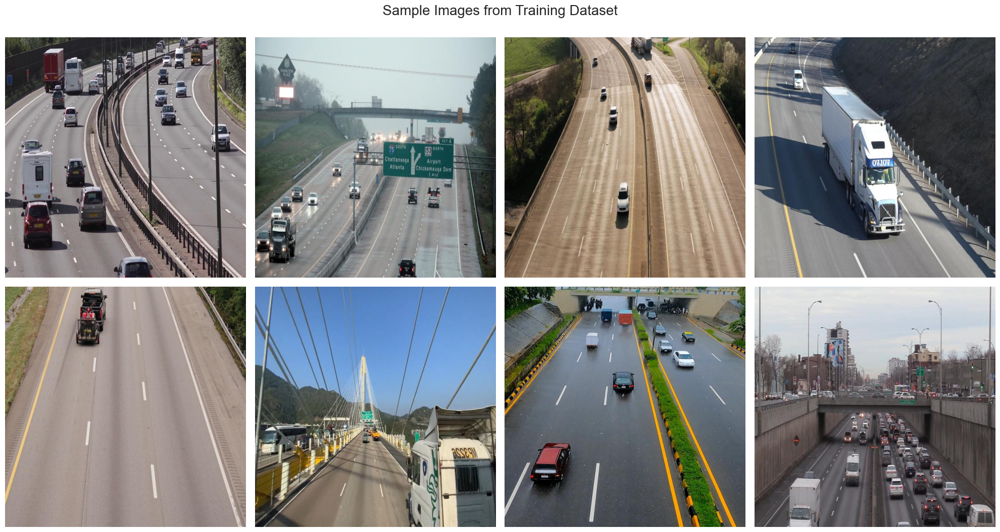

In [7]:
# List all jpg images in the directory

image_files = [file for file in os.listdir(trian_image_path) if file.endswith('.jpg')]

# Select 8 images as eqal intervals
num_images = len(image_files)
selected_images = [image_files[i] for i in range(0, num_images, num_images // 8)]

# Create a 2x4 subplot
fig,axes = plt.subplots(2,4,figsize=(20,11))

# Display each of the selected images
for ax, img_file in zip(axes.ravel(), selected_images):
    img_path =os.path.join(trian_image_path, img_file)
    image = Image.open(img_path)
    ax.imshow(image)
    ax.axis('off')
    
plt.suptitle('Sample Images from Training Dataset',fontsize=20)
plt.tight_layout()
plt.show()

### Training YOLOv11 on Custom Dataset

In [ ]:
# Train the model on out custome dataset
results = model.train(
    data = yaml_file_path,
    epochs = 100,
    imgsz=640,
    batch = 16)

### Performance Evaluation

In [12]:
# Absolute path to the best model weights file
best_model_path = "runs/detect/train/weights/best.pt"

# Load the best model weights into the YOLO model
best_model = YOLO(best_model_path)
data_yaml_path = os.path.join(dataset_path, 'data.yaml')

# Validate the best model using the validation set with default parameters
metrics = best_model.val(data=data_yaml_path, split='val')

Ultralytics 8.3.200  Python-3.9.23 torch-2.0.1+cu118 CUDA:0 (NVIDIA GeForce RTX 3060 Laptop GPU, 6144MiB)
YOLO11n summary (fused): 100 layers, 2,582,347 parameters, 0 gradients, 6.3 GFLOPs
val: Fast image access  (ping: 0.20.0 ms, read: 97.412.5 MB/s, size: 52.2 KB)
val: Scanning C:\Users\Abuelgasim\Downloads\Workshop\Projects\vehicle-counting-project\Vehicle_Dataset\valid\labels.cache... 90 images, 0 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 90/90 36.7Kit/s 0.0s
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 6/6 0.4it/s 13.5s1.3ss
                   all         90        937      0.901      0.955      0.976      0.731
Speed: 8.2ms preprocess, 58.2ms inference, 0.0ms loss, 12.5ms postprocess per image
Results saved to C:\Users\Abuelgasim\Downloads\Workshop\Projects\vehicle-counting-project\runs\detect\val7


### Model Inferance and Generalization Assessment


image 1/1 C:\Users\Abuelgasim\Downloads\Workshop\Projects\vehicle-counting-project\Vehicle_Dataset\valid\images\10_mp4-0_jpg.rf.08b3bd34bbb73fb80c2d662c34474a98.jpg: 640x640 24 Vehicles, 44.6ms
Speed: 1134.3ms preprocess, 44.6ms inference, 20.4ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 C:\Users\Abuelgasim\Downloads\Workshop\Projects\vehicle-counting-project\Vehicle_Dataset\valid\images\11_mp4-15_jpg.rf.b1bdb8b4864b5bed3c78f1a70e2dc011.jpg: 640x640 13 Vehicles, 44.7ms
Speed: 10.3ms preprocess, 44.7ms inference, 5.5ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 C:\Users\Abuelgasim\Downloads\Workshop\Projects\vehicle-counting-project\Vehicle_Dataset\valid\images\12_mp4-27_jpg.rf.2b272befa75f6ccd269223ccc84e5391.jpg: 640x640 5 Vehicles, 44.4ms
Speed: 10.5ms preprocess, 44.4ms inference, 8.6ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 C:\Users\Abuelgasim\Downloads\Workshop\Projects\vehicle-counting-project\Vehicle_Dataset\valid\images\14_m

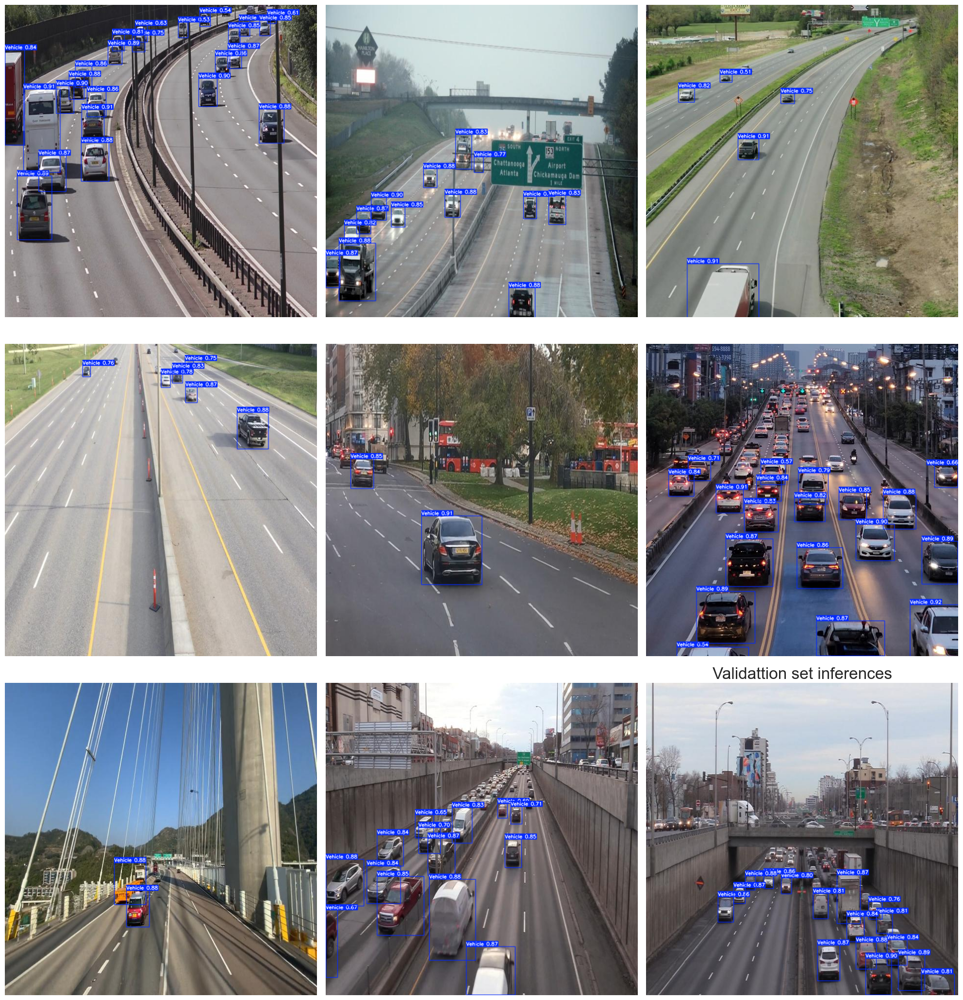

In [13]:
# Interface on validationset
valid_image_path = os.path.join(dataset_path, 'valid','images')

# list all jpg images in the directory
image_files = [file for file in os.listdir(valid_image_path) if file.endswith('.jpg')]

# select 9 images at equal intervals
num_images = len(image_files)
selected_images = [image_files[i] for i in range(0, num_images, num_images // 9)]

# Initailize the subplot
fig, axes = plt.subplots(3,3,figsize=(20,21))
plt.title('Validattion set inferences', fontsize=24)


# Perform inferences on each selected image and display it
for i, ax, in enumerate(axes.flatten()):
    image_path = os.path.join(valid_image_path, selected_images[i])
    results = best_model.predict(source = image_path, imgsz = 640, conf=0.5)
    annotated_image = results[0].plot(line_width=1)
    annotated_image_rgb =cv2.cvtColor(annotated_image, cv2.COLOR_BGR2RGB)
    ax.imshow(annotated_image_rgb)
    ax.axis('off')
    
plt.tight_layout()
plt.show()

### Inference on an unseen test image


image 1/1 C:\Users\Abuelgasim\Downloads\Workshop\Projects\vehicle-counting-project\Vehicle_Dataset\sample_image.jpg: 384x640 6 Vehicles, 29.8ms
Speed: 1222.5ms preprocess, 29.8ms inference, 10.6ms postprocess per image at shape (1, 3, 384, 640)


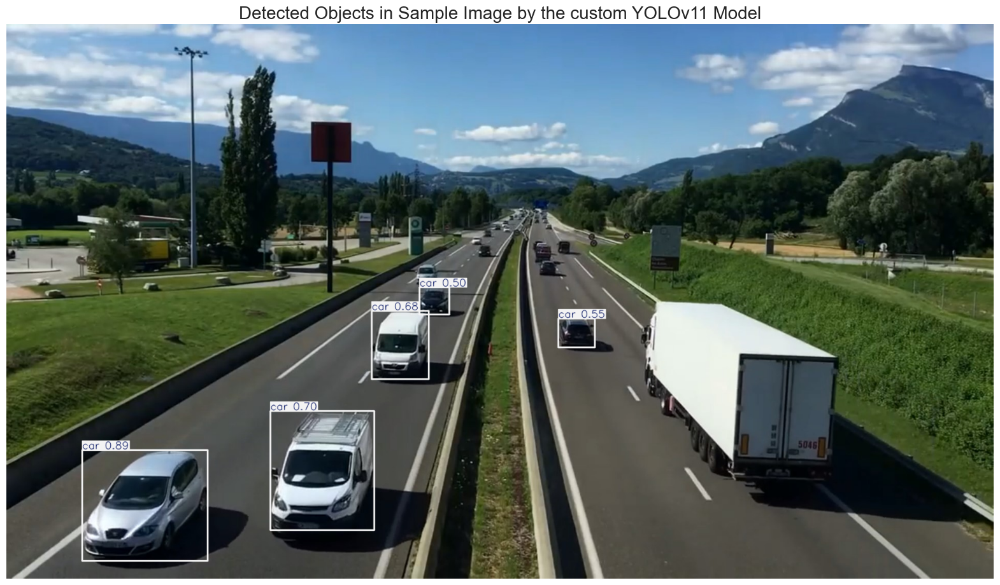

In [19]:
sample_image_path = 'Vehicle_Dataset/sample_image.jpg'

# Perform inference on the provided image using best model
results = best_model.predict(source=sample_image_path, imgsz=640,conf=0.7)

# Annotate and convert image to numpy array
smaple_image = results[0].plot(line_width=2)

# convert the color of the image from BGR to RGB for correct color representation in matplotlib
sample_image = cv2.cvtColor(sample_image, cv2.COLOR_BGR2RGB)

# Display annotated image
plt.figure(figsize=(20,15))
plt.imshow(sample_image)
plt.title('Detected Objects in Sample Image by the custom YOLOv11 Model', fontsize=20)
plt.axis('off')
plt.show()

In [20]:
# Define the path to the sample video in the dataset
video_path = 'Vehicle_Dataset/sample_video.mp4'

# Initiate vehicle detection on the sample video using the best performing model and save the output
best_model.predict(source=video_path, save=True)


WARNING 
inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/601) C:\Users\Abuelgasim\Downloads\Workshop\Projects\vehicle-counting-project\Vehicle_Dataset\sample_video.mp4: 384x640 4 Vehicles, 55.8ms
video 1/1 (frame 2/601) C:\Users\Abuelgasim\Downloads\Workshop\Projects\vehicle-counting-project\Vehicle_Dataset\sample_video.mp4: 384x640 4 Vehicles, 34.9ms
video 1/1 (frame 3/601) C:\Users\Abuelgasim\Downloads\Workshop\Projects\vehicle-counting-project\Vehicle_Dataset\sample_video.mp4: 384x640 4 Ve

[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: 'Vehicle'}
 obb: None
 orig_img: array([[[252, 245, 242],
         [252, 245, 242],
         [252, 245, 242],
         ...,
         [210, 184, 166],
         [210, 184, 166],
         [210, 184, 166]],
 
        [[252, 245, 242],
         [252, 245, 242],
         [252, 245, 242],
         ...,
         [210, 184, 166],
         [210, 184, 166],
         [210, 184, 166]],
 
        [[254, 246, 241],
         [254, 246, 241],
         [254, 246, 241],
         ...,
         [210, 184, 166],
         [210, 184, 166],
         [210, 184, 166]],
 
        ...,
 
        [[ 94, 104, 103],
         [ 96, 106, 105],
         [101, 111, 110],
         ...,
         [ 94, 106, 111],
         [ 95, 107, 112],
         [ 97, 109, 114]],
 
        [[ 98, 108, 107],
         [103, 113, 112],
         [100, 110, 109],
         ...,
         [ 95, 10

In [22]:
# Convert the .avi video to .mp4 format for compatibility with Jupyter Lab
!ffmpeg -y -loglevel panic -i runs/detect/predict/sample_video.avi runs/detect/predict/processed_sample_video.mp4

In [23]:
# Embed and display the processed sample video within the notebook
from IPython.display import Video

# Display the .mp4 video
Video("runs/detect/predict/processed_sample_video.mp4", embed=True, width=960)

### Vehicle Counting Logic

In [24]:
# Define the threshold for considering traffic as heavy
heavy_traffic_threshold = 10

# Define the vertices for the quadrilaterals
vertices1 = np.array([(465, 350), (609, 350), (510, 630), (2, 630)], dtype=np.int32)
vertices2 = np.array([(678, 350), (815, 350), (1203, 630), (743, 630)], dtype=np.int32)

# Define the vertical range for the slice and lane threshold
x1, x2 = 325, 635 
lane_threshold = 609

# Define the positions for the text annotations on the image
text_position_left_lane = (10, 50)
text_position_right_lane = (820, 50)
intensity_position_left_lane = (10, 100)
intensity_position_right_lane = (820, 100)

# Define font, scale, and colors for the annotations
font = cv2.FONT_HERSHEY_SIMPLEX
font_scale = 1
font_color = (255, 255, 255)    # White color for text
background_color = (0, 0, 255)  # Red background for text
        
# Open the video
cap = cv2.VideoCapture('Vehicle_Dataset/sample_video.mp4')

# Define the codec and create VideoWriter object
fourcc = cv2.VideoWriter_fourcc(*'XVID')
out = cv2.VideoWriter('traffic_density_analysis.avi', fourcc, 20.0, (int(cap.get(3)), int(cap.get(4))))

# Read until video is completed
while cap.isOpened():
    # Capture frame-by-frame
    ret, frame = cap.read()
    if ret:
        # Create a copy of the original frame to modify
        detection_frame = frame.copy()
    
        # Black out the regions outside the specified vertical range
        detection_frame[:x1, :] = 0  # Black out from top to x1
        detection_frame[x2:, :] = 0  # Black out from x2 to the bottom of the frame
        
        # Perform inference on the modified frame
        results = best_model.predict(detection_frame, imgsz=640, conf=0.4)
        processed_frame = results[0].plot(line_width=1)
        
        # Restore the original top and bottom parts of the frame
        processed_frame[:x1, :] = frame[:x1, :].copy()
        processed_frame[x2:, :] = frame[x2:, :].copy()        
        
        # Draw the quadrilaterals on the processed frame
        cv2.polylines(processed_frame, [vertices1], isClosed=True, color=(0, 255, 0), thickness=2)
        cv2.polylines(processed_frame, [vertices2], isClosed=True, color=(255, 0, 0), thickness=2)
        
        # Retrieve the bounding boxes from the results
        bounding_boxes = results[0].boxes

        # Initialize counters for vehicles in each lane
        vehicles_in_left_lane = 0
        vehicles_in_right_lane = 0

        # Loop through each bounding box to count vehicles in each lane
        for box in bounding_boxes.xyxy:
            # Check if the vehicle is in the left lane based on the x-coordinate of the bounding box
            if box[0] < lane_threshold:
                vehicles_in_left_lane += 1
            else:
                vehicles_in_right_lane += 1
                
        # Determine the traffic intensity for the left lane
        traffic_intensity_left = "Heavy" if vehicles_in_left_lane > heavy_traffic_threshold else "Smooth"
        # Determine the traffic intensity for the right lane
        traffic_intensity_right = "Heavy" if vehicles_in_right_lane > heavy_traffic_threshold else "Smooth"


        # Add a background rectangle for the left lane vehicle count
        cv2.rectangle(processed_frame, (text_position_left_lane[0]-10, text_position_left_lane[1] - 25), 
                      (text_position_left_lane[0] + 460, text_position_left_lane[1] + 10), background_color, -1)

        # Add the vehicle count text on top of the rectangle for the left lane
        cv2.putText(processed_frame, f'Vehicles in Left Lane: {vehicles_in_left_lane}', text_position_left_lane, 
                    font, font_scale, font_color, 2, cv2.LINE_AA)

        # Add a background rectangle for the left lane traffic intensity
        cv2.rectangle(processed_frame, (intensity_position_left_lane[0]-10, intensity_position_left_lane[1] - 25), 
                      (intensity_position_left_lane[0] + 460, intensity_position_left_lane[1] + 10), background_color, -1)

        # Add the traffic intensity text on top of the rectangle for the left lane
        cv2.putText(processed_frame, f'Traffic Intensity: {traffic_intensity_left}', intensity_position_left_lane, 
                    font, font_scale, font_color, 2, cv2.LINE_AA)

        # Add a background rectangle for the right lane vehicle count
        cv2.rectangle(processed_frame, (text_position_right_lane[0]-10, text_position_right_lane[1] - 25), 
                      (text_position_right_lane[0] + 460, text_position_right_lane[1] + 10), background_color, -1)

        # Add the vehicle count text on top of the rectangle for the right lane
        cv2.putText(processed_frame, f'Vehicles in Right Lane: {vehicles_in_right_lane}', text_position_right_lane, 
                    font, font_scale, font_color, 2, cv2.LINE_AA)

        # Add a background rectangle for the right lane traffic intensity
        cv2.rectangle(processed_frame, (intensity_position_right_lane[0]-10, intensity_position_right_lane[1] - 25), 
                      (intensity_position_right_lane[0] + 460, intensity_position_right_lane[1] + 10), background_color, -1)

        # Add the traffic intensity text on top of the rectangle for the right lane
        cv2.putText(processed_frame, f'Traffic Intensity: {traffic_intensity_right}', intensity_position_right_lane, 
                    font, font_scale, font_color, 2, cv2.LINE_AA)

        # Write the processed frame to the output video
        out.write(processed_frame)
        
        # Uncomment the following 3 lines if running this code on a local machine to view the real-time processing results
        # cv2.imshow('Real-time Analysis', processed_frame)
        # if cv2.waitKey(1) & 0xFF == ord('q'):  # Press Q on keyboard to exit the loop
        #     break
    else:
        break

# Release the video capture and video write objects
cap.release()
out.release()

# Close all the frames
# cv2.destroyAllWindows()


0: 384x640 (no detections), 28.8ms
Speed: 258.5ms preprocess, 28.8ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 28.1ms
Speed: 3.1ms preprocess, 28.1ms inference, 3.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 28.8ms
Speed: 3.8ms preprocess, 28.8ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 27.7ms
Speed: 3.2ms preprocess, 27.7ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 28.7ms
Speed: 4.1ms preprocess, 28.7ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 25.8ms
Speed: 3.2ms preprocess, 25.8ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 26.7ms
Speed: 3.2ms preprocess, 26.7ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 22.6ms
Speed: 2.9ms preprocess, 22.6ms

In [26]:
# Convert the .avi video generated by the traffic density estimation app to .mp4 format
!ffmpeg -y -loglevel panic -i traffic_density_analysis.avi traffic_density_analysis.mp4

In [27]:
# Embed and display the processed sample video within the notebook
from IPython.display import Video

# Display the .mp4 video
Video("traffic_density_analysis.mp4", embed=True, width=960)